# 📘 SCOUT + MVTec AD Integration

This notebook adds support for the MVTec Anomaly Detection dataset—used in anomaly localization/segmentation—by replicating the CIFAR/MNIST pattern in the repo.


In [ ]:

import os
import glob

from PIL import Image

import torch
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader

import torchvision.transforms as T
from torchvision.models import resnet18

from torchcam.methods import GradCAM
from torchcam.utils import overlay_mask

import numpy as np
import matplotlib.pyplot as plt


In [44]:
class MVTecDataset(Dataset):
    def __init__(self, root, category, split='train', resize=(256,256)):
        assert split in ['train','test']
        self.img_paths, self.mask_paths = [], []
        base = os.path.join(root, category, split)
        for label in os.listdir(base):
            for p in glob.glob(os.path.join(base, label, '*.png')):
                self.img_paths.append(p)
                self.mask_paths.append(None if split=='train' else
                    os.path.join(root, category, 'ground_truth', label,
                                 os.path.basename(p).replace('.png','_mask.png')))
        self.transform = T.Compose([
            T.Resize(resize), T.CenterCrop(resize),
            T.ToTensor(),
            T.Normalize([0.485,0.456,0.406],[0.229,0.224,0.225])
        ])

    def __len__(self): return len(self.img_paths)
    def __getitem__(self, i):
        img = self.transform(Image.open(self.img_paths[i]).convert('RGB'))
        mask = (Image.open(self.mask_paths[i]).convert('L')
                if self.mask_paths[i] and os.path.exists(self.mask_paths[i])
                else None)
        if mask is not None:
            mask = T.ToTensor()(mask)
        return img, mask, os.path.basename(self.img_paths[i])


In [45]:
dataset = MVTecDataset(root='F:\\uczelnia\\UJ\\warsztaty sztucznej int\\mvtec_anomaly_detection\\', category='bottle', split='test')
loader = DataLoader(dataset, batch_size=4, shuffle=False)

In [46]:
model = torch.hub.load('pytorch/vision', 'resnet18', pretrained=True).eval()
target_layer = model.layer4[-1]
cam_extractor = GradCAM(model, target_layer)

Using cache found in C:\Users\barto/.cache\torch\hub\pytorch_vision_main


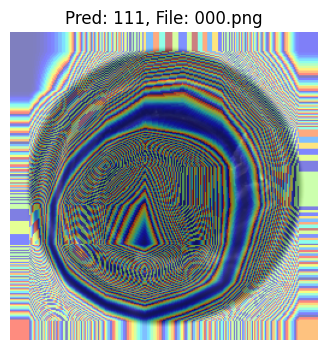

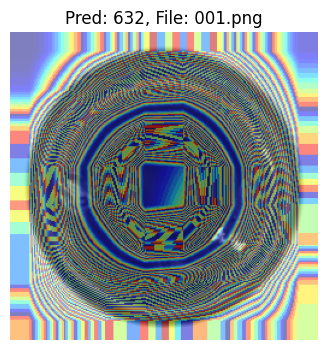

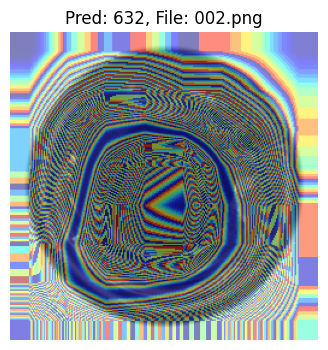

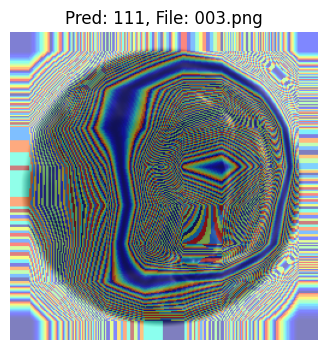

In [47]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F
from PIL import Image
from torchcam.utils import overlay_mask


B = imgs.shape[0]
mean = np.array([0.485, 0.456, 0.406])[None, None, :]
std = np.array([0.229, 0.224, 0.225])[None, None, :]

if isinstance(cams, list) and len(cams) == 1 and isinstance(cams[0], torch.Tensor):
    cam_batch = cams[0] 
else:
    raise RuntimeError(f"Unexpected cams structure: {type(cams)} with elements {[type(x) for x in cams]}")


for i in range(B):
    cam = cam_batch[i] 
    if cam.ndim != 2:
        raise RuntimeError(f"Expected 2D cam after indexing, got {cam.shape}")

    cam_tensor = cam.unsqueeze(0).unsqueeze(0).to(imgs.device) 
    cam_up = F.interpolate(cam_tensor, size=imgs.shape[2:], 
                           mode='bilinear', align_corners=False)  
    heatmap = cam_up.squeeze().cpu().detach().numpy()           

    img_tensor = imgs[i].cpu()               
    img_np = img_tensor.permute(1, 2, 0).numpy() 
    img_np = (img_np * std + mean).clip(0, 1)     
    img_uint8 = (img_np * 255).astype('uint8')    
    pil_img = Image.fromarray(img_uint8)          

    hm = heatmap 
    hm_min, hm_max = float(hm.min()), float(hm.max())
    if hm_max > hm_min:
        hm_norm = (hm - hm_min) / (hm_max - hm_min)
    else:
        hm_norm = np.zeros_like(hm)
    hm_uint8 = (hm_norm * 255).astype('uint8')
    if hm_uint8.ndim != 2:
        hm_uint8 = np.squeeze(hm_uint8)
    if hm_uint8.ndim != 2:
        raise RuntimeError(f"Heatmap after squeeze should be 2D, got {hm_uint8.shape}")

    pil_mask = Image.fromarray(hm_uint8, mode='L')

    result = overlay_mask(pil_img, pil_mask, alpha=0.5)
    plt.figure(figsize=(4, 4))
    plt.imshow(result)
    plt.title(f"Pred: {preds[i].item()}, File: {fnames[i]}")
    plt.axis('off')
    plt.show()


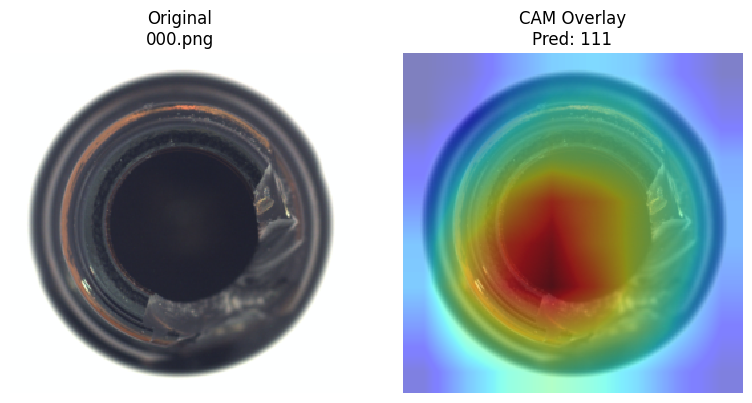

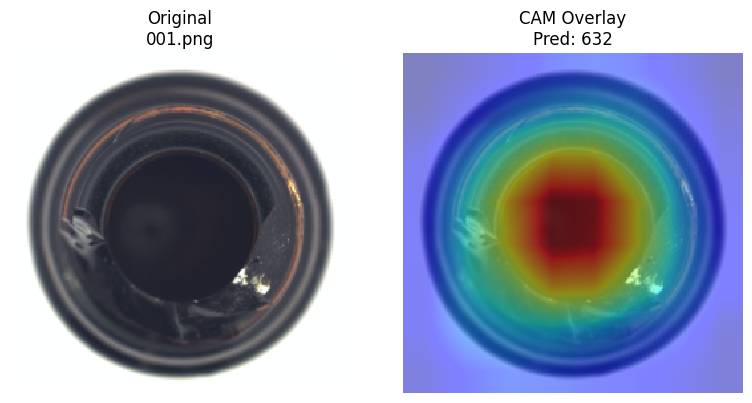

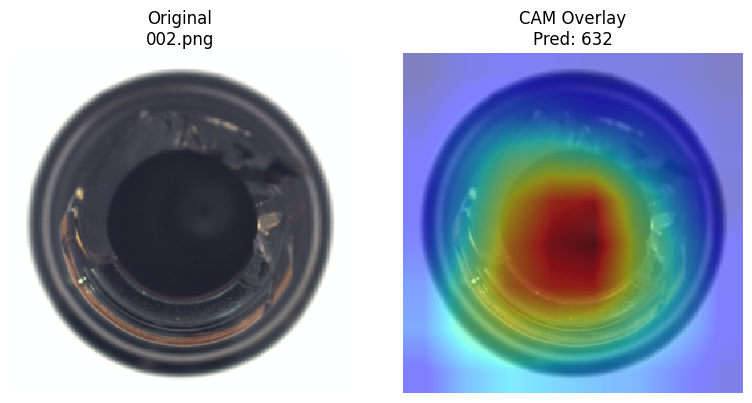

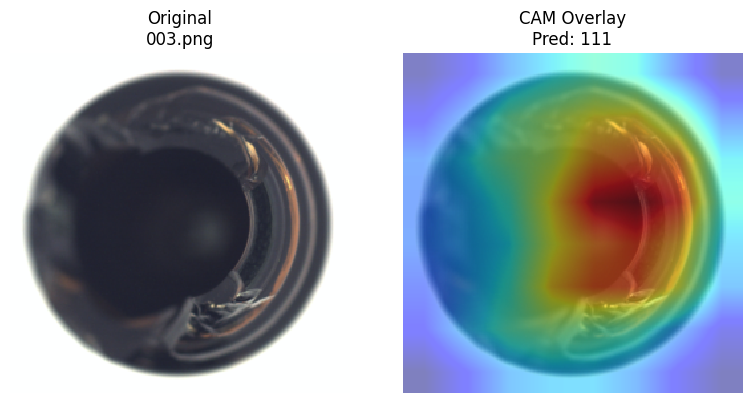

In [48]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn.functional as F

B, _, H, W = imgs.shape

cam_batch = cam_batch.to(imgs.device)               
cam_upsampled = F.interpolate(cam_batch.unsqueeze(1), size=(H, W),
                              mode='bilinear', align_corners=False) 
cam_upsampled = cam_upsampled.squeeze(1)            

mean = np.array([0.485, 0.456, 0.406])[None, None, :]  
std  = np.array([0.229, 0.224, 0.225])[None, None, :]

for i in range(B):
    img_tensor = imgs[i].cpu()                     
    img_np = img_tensor.permute(1, 2, 0).numpy()  
    img_np = (img_np * std + mean).clip(0, 1)    

    heatmap = cam_upsampled[i].cpu().detach().numpy() 
    hm_min, hm_max = float(heatmap.min()), float(heatmap.max())
    if hm_max > hm_min:
        heatmap_norm = (heatmap - hm_min) / (hm_max - hm_min)
    else:
        heatmap_norm = np.zeros_like(heatmap)

    fig, axs = plt.subplots(1, 2, figsize=(8, 4))
    
    axs[0].imshow(img_np, interpolation='nearest')
    axs[0].set_title(f"Original\n{fnames[i] if fnames else ''}")
    axs[0].axis('off')
    
    axs[1].imshow(img_np, interpolation='nearest')
    axs[1].imshow(heatmap_norm, cmap='jet', alpha=0.5, interpolation='bilinear')
    axs[1].set_title(f"CAM Overlay\nPred: {preds[i].item() if 'preds' in globals() else ''}")
    axs[1].axis('off')
    
    plt.tight_layout()
    plt.show()


In [54]:
class MVTecDataset(Dataset):
    def __init__(self, root_dir, transform=None, mask_transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.mask_transform = mask_transform
        self.samples = []

        test_dir = os.path.join(root_dir, "test")
        gt_dir = os.path.join(root_dir, "ground_truth")

        # Loop over anomaly types
        for anomaly_type in os.listdir(test_dir):
            img_folder = os.path.join(test_dir, anomaly_type)
            img_paths = sorted(glob.glob(os.path.join(img_folder, "*.png")))

            for img_path in img_paths:
                # For "good", there is no mask
                if anomaly_type == "good":
                    mask_path = None
                else:
                    fname = os.path.basename(img_path).replace(".png", "_mask.png")
                    mask_path = os.path.join(gt_dir, anomaly_type, fname)

                self.samples.append((img_path, mask_path))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        img_path, mask_path = self.samples[idx]

        img = Image.open(img_path).convert("RGB")

        if mask_path and os.path.exists(mask_path):
            mask = Image.open(mask_path).convert("L")
        else:
            mask = Image.new("L", img.size)  # All-zero mask for "good"

        if self.transform:
            img = self.transform(img)
        if self.mask_transform:
            mask = self.mask_transform(mask)

        fname = os.path.basename(img_path)
        return img, mask, fname


In [56]:
from torchvision import transforms

transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])

mask_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),  # will produce a [1,H,W] tensor
])

category = "bottle"  # or "capsule", "hazelnut", etc.
root_path = f"F:/uczelnia/UJ/warsztaty sztucznej int/mvtec_anomaly_detection/{category}"

dataset = MVTecDataset(root_path, transform=transform, mask_transform=mask_transform)
loader_test = DataLoader(dataset, batch_size=4, shuffle=False)



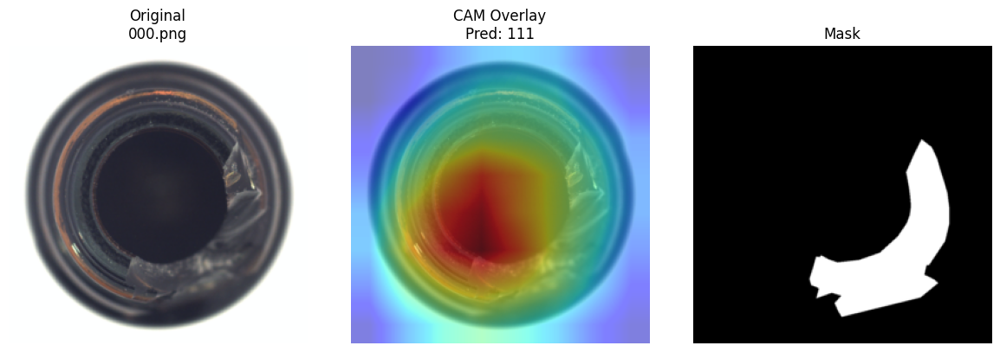

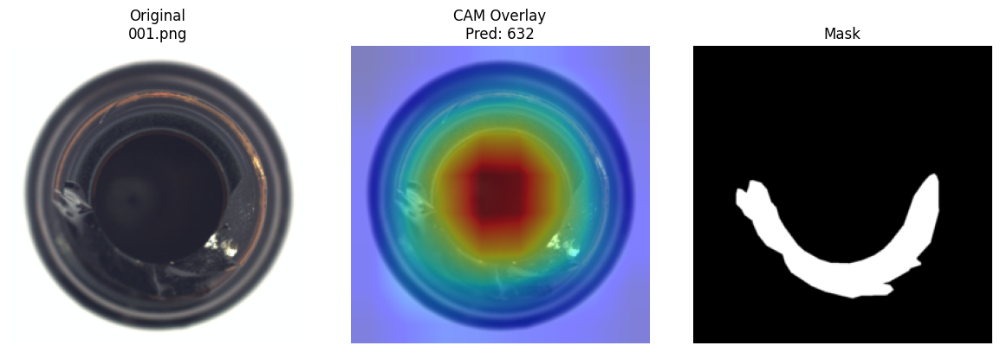

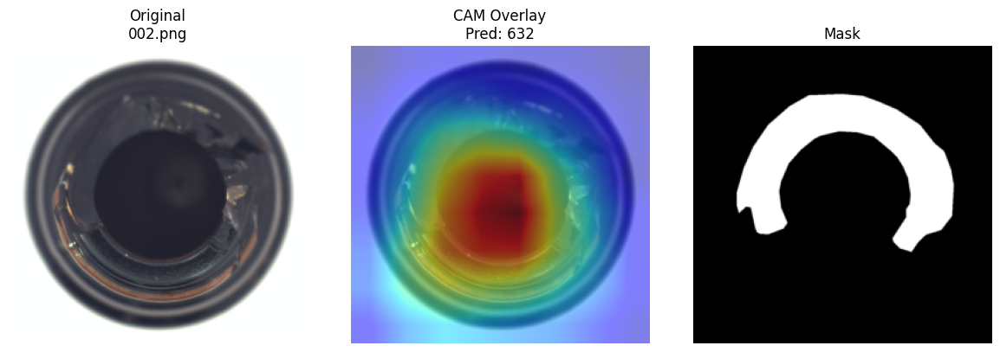

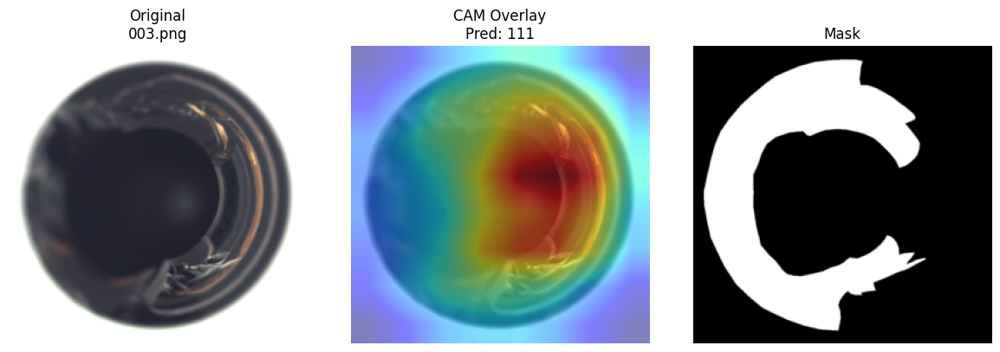

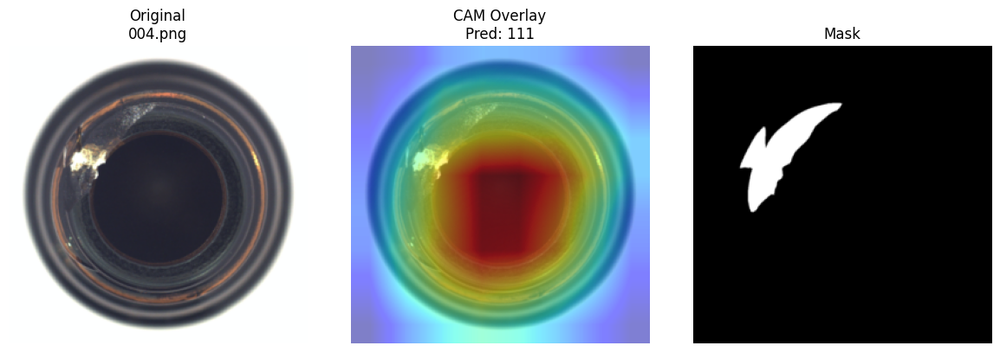

...

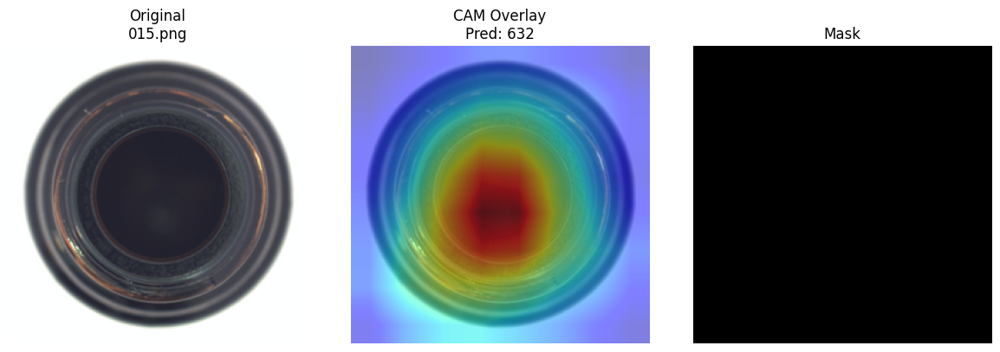

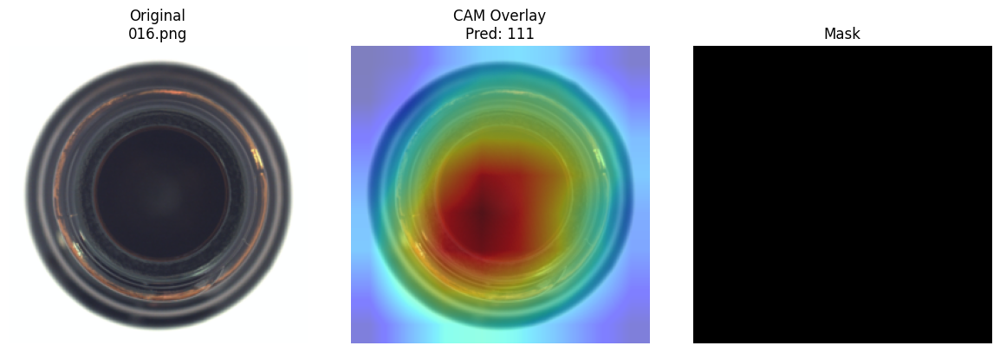

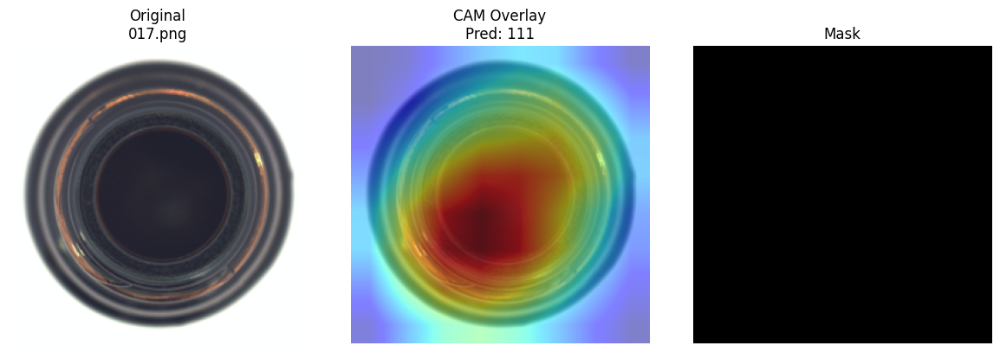

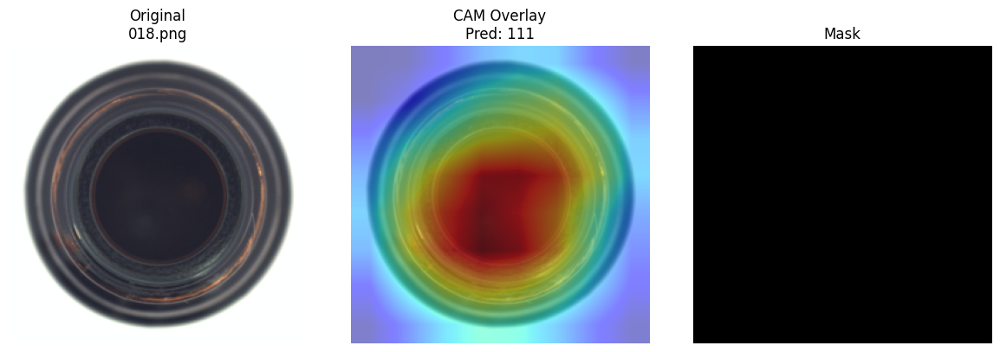

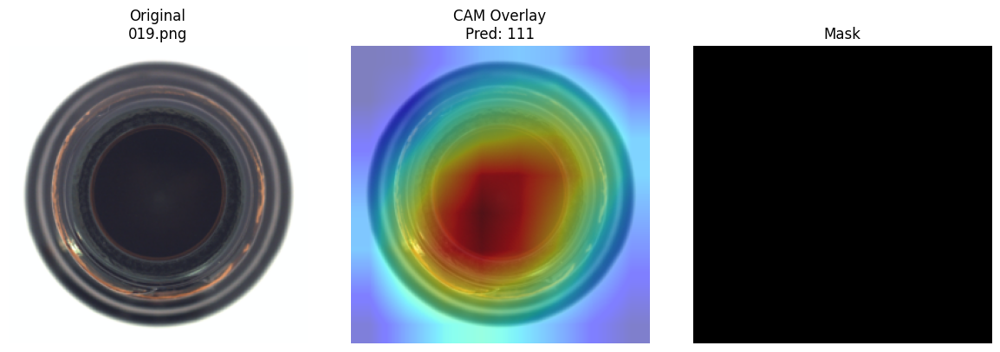

In [ ]:
from torchvision import transforms
class MVTecDataset(Dataset):
    def __init__(self, root_dir, transform=None, mask_transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.mask_transform = mask_transform
        self.samples = []

        test_dir = os.path.join(root_dir, "test")
        gt_dir = os.path.join(root_dir, "ground_truth")

        for anomaly_type in os.listdir(test_dir):
            img_folder = os.path.join(test_dir, anomaly_type)
            img_paths = sorted(glob.glob(os.path.join(img_folder, "*.png")))

            for img_path in img_paths:
                if anomaly_type == "good":
                    mask_path = None
                else:
                    fname = os.path.basename(img_path).replace(".png", "_mask.png")
                    mask_path = os.path.join(gt_dir, anomaly_type, fname)

                self.samples.append((img_path, mask_path))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        img_path, mask_path = self.samples[idx]

        img = Image.open(img_path).convert("RGB")

        if mask_path and os.path.exists(mask_path):
            mask = Image.open(mask_path).convert("L")
        else:
            mask = Image.new("L", img.size)

        if self.transform:
            img = self.transform(img)
        if self.mask_transform:
            mask = self.mask_transform(mask)

        fname = os.path.basename(img_path)
        return img, mask, fname

transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])

mask_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),  
])

category = "bottle"
root_path = f"F:/uczelnia/UJ/warsztaty sztucznej int/mvtec_anomaly_detection/{category}"

dataset = MVTecDataset(root_path, transform=transform, mask_transform=mask_transform)
loader_test = DataLoader(dataset, batch_size=4, shuffle=False)


import torch
import torch.nn.functional as F
from torchcam.methods import GradCAM

def compute_cam_heatmap(model, target_layer, input_tensor, class_idx):
    """
    Generate a CAM heatmap for a single input image.
    input_tensor: torch.Tensor of shape [1, 3, H, W].
    class_idx: int (predicted class index).
    Returns: heatmap numpy array [H, W].
    """
    cam_extractor = GradCAM(model, target_layer=target_layer)
    
    scores = model(input_tensor) 
    
    cam = cam_extractor(class_idx=class_idx, scores=scores)[0] 
    
    if not isinstance(cam, torch.Tensor):
        cam = torch.tensor(cam)
    
    if cam.ndim == 2:
        cam_tensor = cam.unsqueeze(0).unsqueeze(0)
    elif cam.ndim == 3:

        cam_tensor = cam.unsqueeze(0)
    elif cam.ndim == 4 and cam.shape[0] == 1:

        cam_tensor = cam
    else:
        raise ValueError(f"Unexpected CAM tensor shape: {cam.shape}")
    

    cam_up = F.interpolate(cam_tensor, size=input_tensor.shape[-2:], mode='bilinear', align_corners=False)
    
    cam_up = cam_up.squeeze(0) 
    if cam_up.ndim == 3:
        cam_up = cam_up.mean(dim=0) 
    heatmap = cam_up.cpu().detach().numpy() 
    return heatmap


device = 'cuda' if torch.cuda.is_available() else 'cpu'
model = model.to(device).eval()
target_layer = model.layer4[-1]

def visualize_image_heatmap_mask(img_tensor, heatmap, mask_tensor=None, preds=None, fname=None):

    mean = np.array([0.485, 0.456, 0.406]).reshape(3,1,1)
    std = np.array([0.229, 0.224, 0.225]).reshape(3,1,1)
    img_np = img_tensor.cpu().numpy()
    img_np = (img_np * std) + mean
    img_np = np.clip(img_np, 0, 1)
    img_np = np.transpose(img_np, (1,2,0))

    heatmap_norm = (heatmap - np.min(heatmap)) / (np.max(heatmap) - np.min(heatmap) + 1e-8)

    cmap = plt.get_cmap('jet')
    heatmap_color = cmap(heatmap_norm)[..., :3]
    overlay = 0.5 * img_np + 0.5 * heatmap_color
    overlay = np.clip(overlay, 0, 1)

    ncols = 3 if mask_tensor is not None else 2
    fig, axs = plt.subplots(1, ncols, figsize=(4*ncols, 4))
    axs[0].imshow(img_np)
    axs[0].set_title(f"Original\n{fname}" if fname else "Original")
    axs[0].axis('off')
    axs[1].imshow(overlay)
    axs[1].set_title(f"CAM Overlay\nPred: {preds}" if preds is not None else "CAM Overlay")
    axs[1].axis('off')
    if mask_tensor is not None:
        mask_np = mask_tensor.squeeze().cpu().numpy()
        axs[2].imshow(mask_np, cmap='gray')
        axs[2].set_title("Mask")
        axs[2].axis('off')
    plt.tight_layout()
    plt.show()

for imgs, masks, fnames in loader_test:
    imgs = imgs.to(device)
    outputs = model(imgs)
    preds = outputs.argmax(dim=1).tolist()
    for i in range(imgs.shape[0]):
        img = imgs[i]  
        pred = preds[i]
        heatmap = compute_cam_heatmap(model, target_layer, img.unsqueeze(0), pred)
        mask = masks[i] 
        visualize_image_heatmap_mask(img, heatmap, mask_tensor=mask, preds=pred, fname=fnames[i])
